编写与修订：@\_散沙\_Python玩家\_

# Concrete Math with Python VI
### Python带你游览具体世界的数学基础

一般来说，高深的数学总会让人有种抗拒心理，但跟具体世界紧密联系的简单数学知识会则不容易让人有如下的疑问：

**"我们知道这些知识到底有什么用处？"**

这些数学知识第一次出现在高中、大学课本时可能会让人摸不到头脑，而他们往往是基础的计算机科学、统计学、经济学知识的基石。

这部分内容包括：

* 数列与金融基础
* 排列组合与概率基础
* 方程组/矩阵
* 线性规划
* 质数与加密
* 随机数与概率分布

### 注意：具备扎实的高中数学、理工科本科数学基础的朋友可以简单阅览或者跳过这一部分。

# 1. 大自然的概率分布

In [2]:
import itertools as itt
import numpy as np
import numpy.random as nprnd
import scipy.stats as spstat
import scipy.special as ssp
import pandas as pd
import bokeh
import bokeh.plotting as bplt
import bokeh.palettes as bpal



NumPy的random下有很多能够生成特定分布随机数的方法，是我们感性地学习概率分布的好帮手。

In [7]:
print nprnd.__all__

['beta', 'binomial', 'bytes', 'chisquare', 'exponential', 'f', 'gamma', 'geometric', 'get_state', 'gumbel', 'hypergeometric', 'laplace', 'logistic', 'lognormal', 'logseries', 'multinomial', 'multivariate_normal', 'negative_binomial', 'noncentral_chisquare', 'noncentral_f', 'normal', 'pareto', 'permutation', 'poisson', 'power', 'rand', 'randint', 'randn', 'random_integers', 'random_sample', 'rayleigh', 'seed', 'set_state', 'shuffle', 'standard_cauchy', 'standard_exponential', 'standard_gamma', 'standard_normal', 'standard_t', 'triangular', 'uniform', 'vonmises', 'wald', 'weibull', 'zipf', 'ranf', 'random', 'sample']


SciPy的stats下有很多概率分布的

* 采样工具
* 分布函数曲线与数字特征
* 各种检验下的p值计算
* 非参数工具

In [4]:
print spstat.__all__

['absolute_import', 'alpha', 'anderson', 'anderson_ksamp', 'anglit', 'ansari', 'arcsine', 'bartlett', 'bayes_mvs', 'bernoulli', 'beta', 'betai', 'betaprime', 'binned_statistic', 'binned_statistic_2d', 'binned_statistic_dd', 'binom', 'binom_test', 'boltzmann', 'boxcox', 'boxcox_llf', 'boxcox_normmax', 'boxcox_normplot', 'bradford', 'burr', 'callable', 'cauchy', 'chi', 'chi2', 'chi2_contingency', 'chisqprob', 'chisquare', 'circmean', 'circstd', 'circvar', 'combine_pvalues', 'contingency', 'cosine', 'cumfreq', 'describe', 'dgamma', 'dirichlet', 'distributions', 'division', 'dlaplace', 'dweibull', 'entropy', 'erlang', 'expon', 'exponnorm', 'exponpow', 'exponweib', 'f', 'f_oneway', 'f_value', 'f_value_multivariate', 'f_value_wilks_lambda', 'fastsort', 'fatiguelife', 'find_repeats', 'fisher_exact', 'fisk', 'fligner', 'foldcauchy', 'foldnorm', 'frechet_l', 'frechet_r', 'friedmanchisquare', 'futil', 'gamma', 'gausshyper', 'gaussian_kde', 'genexpon', 'genextreme', 'gengamma', 'genhalflogistic',

如果不使用推荐的bokeh绘图而用内置的matplotlib进行inline的绘图，需要进行以下调整

In [5]:
%matplotlib inline
%pylab inline
import matplotlib.pyplot as plt
import pylab as pl
from matplotlib.font_manager import FontProperties
fontPath = r"/Users/wangweiyang/Anaconda/lib/python2.7/site-packages/matplotlib/mpl-data/fonts/ttf/msyh.ttf"
fontx = FontProperties(fname=fontPath, size=10)

Populating the interactive namespace from numpy and matplotlib


上面的代码中最后几行是为了让Matplotlib能够显示中文的，除了执行以上代码以外还需要在系统中进行如下设置：

*   修改matplotlibrc,找到找到以下两项，去掉#号
    * font.family         : sans-serif        
    * font.sans-serif     : Microsoft YaHei, Bitstream Vera Sans, Lucida Grande, Verdana, Geneva, Lucid, Arial, Helvetica, Avant Garde, sans-serif
* 为font.sans-serif中添加“Microsoft YaHei”,该行指示缺省字体
* 在上述fontPath中增加msyh.ttf的绝对路径

### 1.1 大数定律

大数定律（Law of Large Number）：只要数够大，样本均值就会趋近于分布均值

要不要猜一下Beta(2,1)分布的均值？


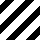
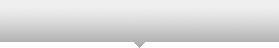
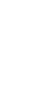
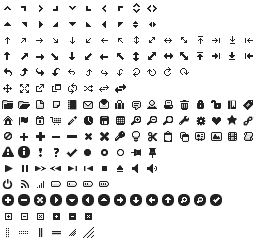
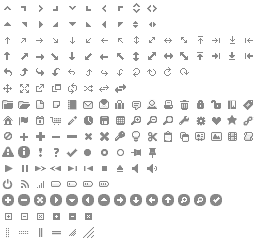
...
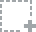
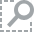
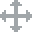
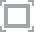
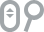

In [129]:
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="Beta(2,1)分布均值收敛",
       background_fill="#FFFFFF",x_axis_type="log",y_axis_type="log",**plot_config)

#from bokeh.models import Range1d
Narr = (np.arange(200)+2)**2 * 20

betamean = np.zeros_like(Narr,dtype=np.float64)
for idx,i in enumerate(Narr):
    betamean[idx] = np.mean(nprnd.beta(2,1,i))

p1.set(x_range=bokeh.models.Range1d(Narr.min(), Narr.max()))

p1.line(Narr, betamean, line_width=3, color='#3288bd', legend='Beta(2,1)')

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '样本点数'
p1.yaxis.axis_label = '均值'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

似乎是收敛到2/3了？

In [15]:
print spstat.beta(2,1).mean()

0.666666666667


对于一个分布的数字特征，总是可以简单的用如下方法快速得到，验证公式：

In [16]:
print spstat.beta(2,1).mean(), 2.0/(2+1)
print spstat.beta(2,1).var(), 2*1.0/(2+1+1)/(2+1)**2

0.666666666667 0.666666666667
0.0555555555556 0.0555555555556


### 1.2 中心极限定理：正态分布

把一个小球扔进这个钉板，每次小球下落的时候会随机的向左或者向右弹开半格的位置，继续下落，继续向左或者向右移动

最后非常随机的落入底下的某一长条格子中。如果增加钉板的大小，增加长条格子的数量，我们能看到一个类似正态分布的直方图。

这就是著名的Galton钉板试验。

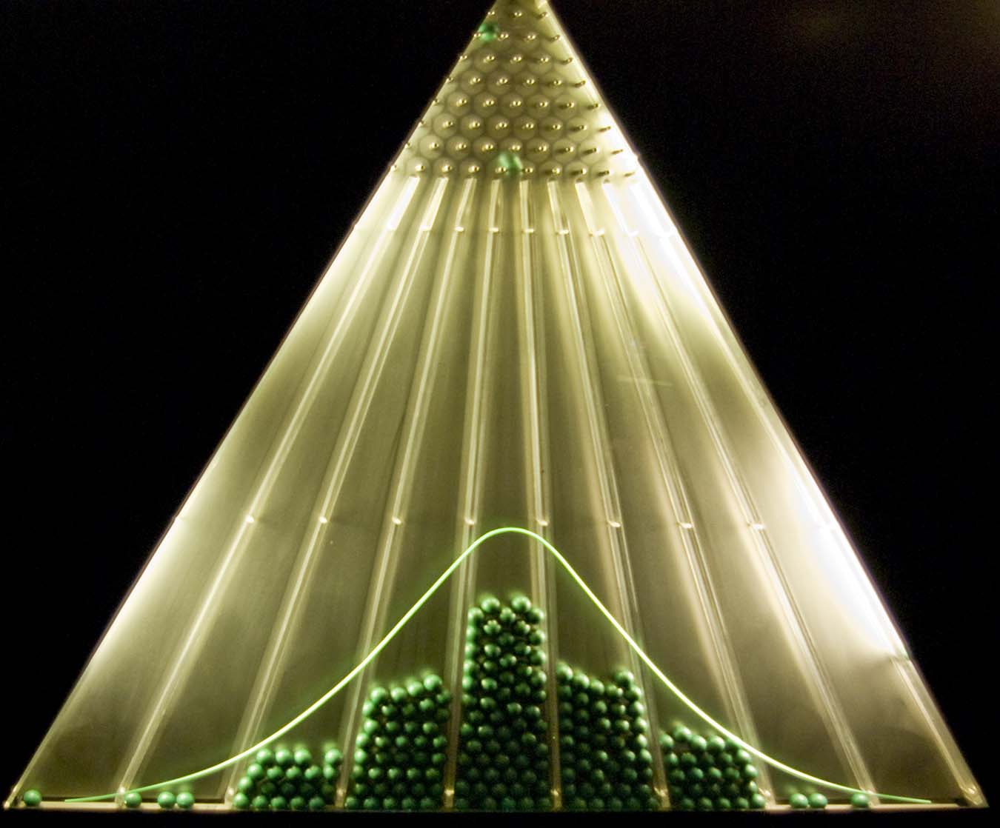

In [1]:
from IPython.display import Image
Image(filename="S2EP6_Planche_de_Galton.jpg",width=400)

用数学的语言来描述这个问题：

小球每次下落时水平方向的位移是一个随机变量$X_i$，

$$P(X_i=-1)=0.5,P(X_i=1)=0.5$$

很多次移动之后小球的水平方向总位移是

$$X = \Sigma_{i=1}^{N} X_i$$

这个总的X应该是越来越接近正态分布的。

##概率论第一个杀手级别的定理：中心极限定理

$\sqrt{N}(\bar{X}-\mu) \xrightarrow{\mathcal{D}} \mathcal{N}(0,\sigma^2)$

*   N: 样本数目
*   $\mu$: 分布均值
*   $\sigma$: 分布方差
*   $\mathcal{N}$: 正态分布

使用随机数生成＋核函数，而不是用直方图来验证连续型分布，这种分布更像概率密度函数：

发现恰好与正态分布形状一致

正态分布$N(\mu,\sigma^2)$: $f(x) = \frac{1}{\sqrt{2\pi\sigma^2}} e^{-\frac{(x-\mu)^2}{2\sigma^2}}$

并且$N(\mu,\sigma^2) \sim \mu + N(0,1)*\sigma$


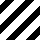
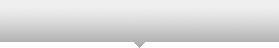
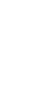
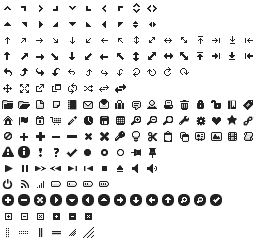
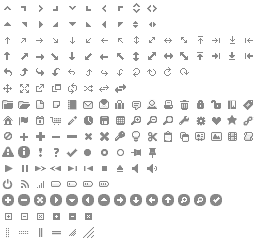
...
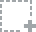
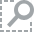
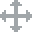
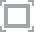
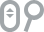

In [135]:
N = (np.arange(5)+1)**2
M = 10000

betaCLT = np.zeros((len(N),M),dtype=np.float64)

for idx,x in enumerate(N):
    for j in xrange(M):
        betaCLT[idx,j] = (np.mean(nprnd.beta(2,1,x))-2.0/3)*np.sqrt(x) * 6.0/np.sqrt(2)

# 配色配置
colors = bpal.brewer['RdBu'][6]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="随机模拟正态分布与标准正态分布",
       background_fill="#FFFFFF",**plot_config)

#from bokeh.models import Range1d
for i in xrange(len(N)):
    density = spstat.gaussian_kde(betaCLT[i,:])
    xs = np.linspace(-5,5,200)
    density.covariance_factor = lambda : .15
    density._compute_covariance()
    p1.line(xs, density(xs), line_width=3, color=colors[5-i], legend='N={0:>3}'.format(N[i]))

p1.line(xs,spstat.norm.pdf(xs),line_width=3,color='black',legend='N = Inf')
p1.set(x_range=bokeh.models.Range1d(-5, 5))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

回顾大数定理：“放大100倍，抖动幅度缩减10倍”

### 1.3 更深入了解分布？建议了解大自然的规律

*   分布在给定条件下服从最大熵原理
    *    拉格朗日法 https://en.wikipedia.org/wiki/Lagrange_multiplier
    *    变分法 https://en.wikipedia.org/wiki/Calculus_of_variations
    *    最大熵原理 https://en.wikipedia.org/wiki/Principle_of_maximum_entropy
*   统计物理通过状态转移概率矩阵来获得其解析的或近似的分布形式
    *    离散状态随机过程 https://en.wikipedia.org/wiki/Stochastic_process#Discrete_time_and_discrete_states
    *    Boltzmann分布 https://en.wikipedia.org/wiki/Boltzmann_distribution
*   随机模拟通过MCMC来实现获得分布模拟，或者在其上直接进行其他数学实验
    *    Metropolis Hastings https://en.wikipedia.org/wiki/Metropolis–Hastings_algorithm
    *    Gibbs Sampling https://en.wikipedia.org/wiki/Gibbs_sampling

# 2. 计算机界的概率分布

### 2.1 用有限的值域近似无限的随机数

*   int8:     -128   ~ 127
*   int16:    -32768 ~ 32767
*   int32:    -$2^{31}$ ~ $2^{31}$-1
*   int64:    -$2^{63}$ ~ $2^{63}$-1
*   uint8:         0 ~ 255
*   uint16:        0 ~ 65535
*   uint32:        0 ~ $2^{32}$-1
*   uint64:        0 ~ $2^{64}$-1
*   float16:   符号＋5bit指数＋10bit小数
*   float32:   符号＋8bit指数＋23bit小数
*   float64:   符号＋11bit指数＋52bit小数
*   complex64:  单精度浮点复数
*   complex128: 双精度浮点复数

我们仅用x个bit(0-1位)，故至多表示$2^x$个**离散**的数值。（更详细的浮点数内容请参考：IEEE Standard 754）

### 2.2 “好的”随机数生成器与标准均匀分布

$U(0,1)$: “均匀的"从0到1的实数中选取一个

$U(a,b) \sim a+(b-a)U(0,1)$: “均匀的"从a到b的实数中选取一个

好的随机数生成器应该满足

*   服从给定分布
*   无自相关
*   给定种子可重复（伪随机）

常见的随机数生成器（C，各种BLAS等）：如果你还记得“梅森素数”的话，一定要知道MT-19937算法，因为$2^{19937}-1$是一个梅森素数。

*   Mersenne Twister http://en.wikipedia.org/wiki/Mersenne_Twister

#### 当我们想要U(0,1):


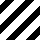
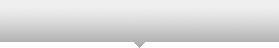
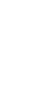
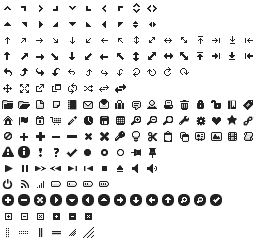
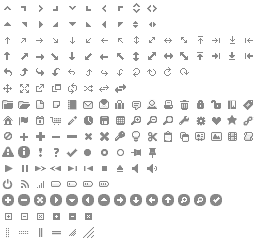
...
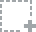
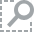
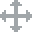
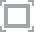
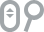

In [49]:
x = np.random.rand(1e5)
xs = np.linspace(-0.2,1.2,300)
density = spstat.gaussian_kde(x)
density.covariance_factor = lambda : .02
density._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="随机模拟均匀分布与真实均匀分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density(xs), line_width=3, color=colors[1-i], legend='模拟分布')
p1.line(xs,spstat.uniform().pdf(xs),line_width=3,color='black',legend='均匀分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

#### 当我们想要某个叫做指数分布的分布Exp(1)

$Exp(\lambda) \sim Exp(1)/\lambda$


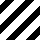
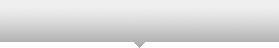
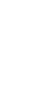
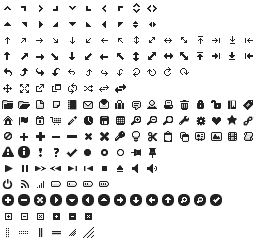
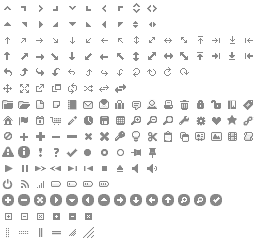
...
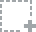
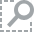
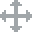
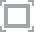
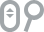

In [51]:
x = np.random.rand(1e5)
x = - np.log(x) # 来自均匀分布经过函数转换
xs = np.linspace(-0.2,3,300)
density = spstat.gaussian_kde(x)
density.covariance_factor = lambda : .02
density._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="随机模拟指数分布与真实指数分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density(xs), line_width=3, color=colors[1-i], legend='模拟分布')
p1.line(xs,spstat.expon().pdf(xs),line_width=3,color='black',legend='指数分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

#### 当我们想要一个在1-4上的均匀分布

[1 2 4 3 1 2 4 3 1 2 4 3 1 2 4 3 1 2 4 3]



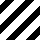
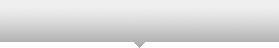
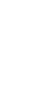
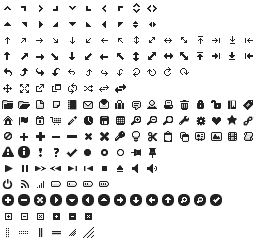
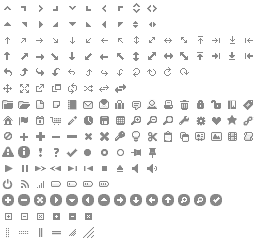
...
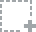
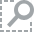
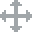
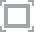
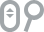

In [4]:
x = pd.Series(np.array([(2**i)%5 for i in xrange(10000)]))
print x[:20].values
colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

vc = x.value_counts().sort_index()
classname = [str(x) for x in vc.index]
classfreq = np.array(vc.values)

p1 = bplt.figure(title="1~4频数统计",
            x_range=classname, y_range=[0, max(classfreq)+100],
            background_fill='#59636C', **plot_config)

# use the `rect` renderer to display stacked bars of the medal results. Note
# that we set y_range explicitly on the first renderer
p1.rect(x=classname, y=classfreq/2, width=0.8, height=classfreq, color="white", alpha=0.6)

bplt.show(p1)

分布倒是均匀，可是并不真的随机！

因为这是一个循环的数列，你能够精确的知道x这个序列每一个位置是什么。

#### 可以重现的随机数生成序列

* 可以重现的随机数生成序列也只能叫伪随机，因为如果想要做多次实验收集不同结果时伪随机序列无法满足。
* 伪随机数有一个好处：测试一个算法的两种实现时，如果输入相同的伪随机数应该得到一致的结果。

我们来看一下伪随机数的概念：

NumPy的random中有个seed函数，它是“设置随机数种子”的意思，同样的种子能够导致random的其他方法产生同样的随机序列。

In [38]:
for i in xrange(3):
    np.random.seed(0)
    print nprnd.beta(2,1,6)

np.random.seed(0)    

for i in xrange(3):
    #np.random.seed(0)
    print spstat.beta(2,1).rvs(6)

[ 0.86716215  0.68316348  0.86937866  0.66270128  0.96905629  0.5057031 ]
[ 0.86716215  0.68316348  0.86937866  0.66270128  0.96905629  0.5057031 ]
[ 0.86716215  0.68316348  0.86937866  0.66270128  0.96905629  0.5057031 ]
[ 0.86716215  0.68316348  0.86937866  0.66270128  0.96905629  0.5057031 ]
[ 0.58977924  0.58475563  0.4209777   0.59576436  0.78400889  0.47801871]
[ 0.79828678  0.88390508  0.5308493   0.93149258  0.52822535  0.58509245]


### 2.3 From One To Many：从一种随机数生成任意随机数

计算机最喜欢均匀分布了，介绍一篇扩展阅读：https://en.wikipedia.org/wiki/Mersenne_Twister

刚才的均匀分布以及指数分布的例子说明，随机数之间可以通过函数来互相转换。

###对于离散随机分布

可以通过对连续的$U(0,1)$离散化，了解这个分布的含义直接进行模拟。

比如一个离散分布X：

$$P(X=1)=0.1,P(X=2)=0.2,P(X=3)=0.3,P(X=4)=0.4$$

我们先生成一组$u \sim U(0,1)$

然后进行如下变换就能得到想要的离散随机分布

$$X = \left\{\begin{aligned}
        & 1 , \text{if  } 0 \leq u \lt 0.1 \\
        & 2 , \text{if  } 0.1 \leq u \lt 0.3 \\ 
        & 3 , \text{if  } 0.3 \leq u \lt 0.6 \\
        & 4 , \text{if  } 0.6 \leq u \lt 1 
    \end{aligned}
    \right.$$

###对于连续随机分布

我们可以用$-log(U(0,1)) \sim Exp(1)$的方式进行转换。

如果你能知道一个随机分布T的 累积概率分布（Cumulative Distribution Function）F，你就可以用

$T = F^{-1}(U)$ 来生成T的分布了。

比如我知道Exp(1)的概率密度函数是

$f(x) = e^{-x}$, 于是 $F(x)=\int_0^x e^{-x} = 1-e^{-x}$

于是： $-log(1-U(0,1)) \sim Exp(1)$，因为$1-U(0,1) \sim U(0,1) $

接下来，仅仅凭借均匀分布走遍天下吧！

# 3. 离散分布

离散分布最好用直方图来表示Probability Mass Function。

### 3.1 二值分布，或称伯努利分布(Bernoulli Distribution)

具体：两人反复进行比赛，其中前者赢得比赛的概率是p，赢得比赛计为1，否则为0，每一场比赛结果独立而且随机时就为Bernoulli分布。

抽象：Bernoulli(p)以概率p取到1，以概率1-p取到0，也就是P(X=1) = p


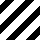
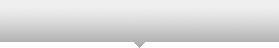
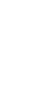
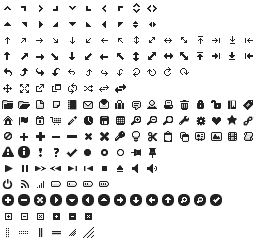
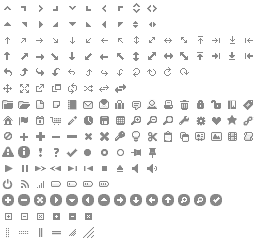
...
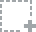
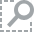
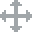
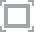
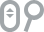

In [114]:
p = nprnd.rand()
x = pd.Series(np.int64(nprnd.rand(1e5)<p)).value_counts()
xi = np.array(x.index)
xv = x.values
colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="伯努利分布模拟频数统计与理论频数期望",
            background_fill='#59636C', y_range = [-1e4,xv.max()+1e4], **plot_config)

# use the `rect` renderer to display stacked bars of the medal results. Note
# that we set y_range explicitly on the first renderer
xs = np.linspace(-1,2,100)
p1.rect(x=xi,y=xv/2,width=0.6, height=xv, color="white", alpha=0.6)
p1.line(xs,spstat.bernoulli(p).pmf(xs)*1e5,line_width=3,color="steelblue",legend="频数期望")
p1.legend.label_text_color = "white"

bplt.show(p1)

###3.2 多值分布(Multi Value Distribution)

具体：4个人打麻将，分别取得胜利的概率为$p_i,i=0,1,2,3$而且$\Sigma_i p_i = 1$

$P(X = i) = p_i$

抽象：这个[1/4,1/4,1/4,1/4]叫做超参数，是他们通过Dirichlet分布生成了多值分布的参数（也就是每个人的胜利概率）


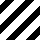
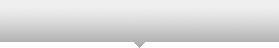
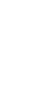
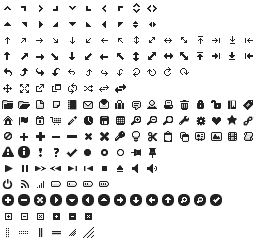
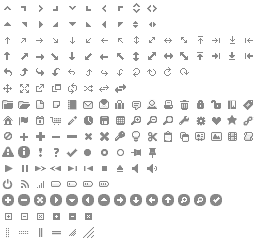
...
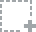
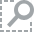
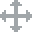
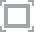
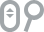

In [136]:
dirichlet = spstat.dirichlet(np.ones(4)/4.0).rvs() #这时用Dirichlet分布直接生成一组随机数更方便
#print dirichlet
cs_dirichlet = np.cumsum(dirichlet) #累计加和
#print cs_dirichlet
dict_dirichlet = {(4-i):dirichlet[0,i] for i in xrange(4)} #
#print dict_dirichlet
p = nprnd.rand(1e5)
p_discrete = np.zeros_like(p,dtype=np.int64)
for i in cs_dirichlet:
    p_discrete += p<i
x = pd.Series(p_discrete).value_counts().sort_index()

xi = np.array(x.index)
xv = x.values
colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="多值分布模拟频数统计与理论频数期望",
            background_fill='#59636C', y_range = [-1e4,xv.max()+1e4], **plot_config)

# use the `rect` renderer to display stacked bars of the medal results. Note
# that we set y_range explicitly on the first renderer
xs = np.linspace(0,5,121)
p1.rect(x=xi,y=xv/2,width=0.6, height=xv, color="white", alpha=0.6)
p1.line(xs,np.array([dict_dirichlet[x] if x in dict_dirichlet else 0 for x in xs ])*1e5,\
        line_width=3,color="steelblue",legend="频数期望")
p1.legend.label_text_color = "white"

bplt.show(p1)

### 3.3 排列与组合的威力：二项分布(Binomial Distribution)、多项分布(Multinomial Distribution)

二项分布就是重复的Bernoulli实验，对2种结果计数。

类似的，多项分布就是重复的多值分布实验，对每一种不同结果分别计数，当只关心某一种结果时仍然是二项分布。

二项分布：$Binomial(N,p) \xrightarrow{\mathcal{D}} \Sigma_{N,i.i.d} Bernoulli(p)$

从排列组合角度看，

二项分布的PMF：$P(X = k) = $ $N \choose k$ $p^k(1-p)^{N-k}$

多项分布的PMF：$P(X_1 = k_1, X_2 = k_2 , ... X_n = k_n) =$ $N\choose {k_1,k_2,... k_n} $ $p_1^{k_1}p_2^{k_2}...p_n^{k_n}$

0.599677519593



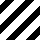
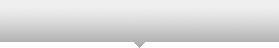
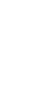
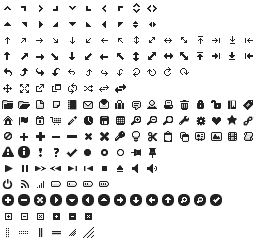
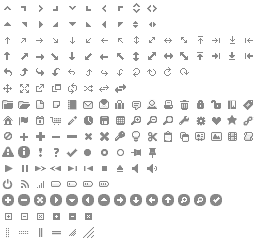
...
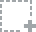
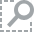
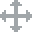
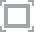
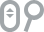

In [116]:
N = 10
M = 1e5
p = nprnd.rand()*0.5+0.25
print p

binomial_simresult = np.zeros((M,),dtype=np.int64)
for i in xrange(N):
    binomial_simresult += nprnd.rand(M)<p

xs = np.linspace(-1,11,121)
x = pd.Series(binomial_simresult).value_counts().sort_index()
xi = np.array(x.index)
xv = x.values
colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="二项分布模拟频数统计与理论频数期望",
            background_fill='#59636C', y_range = [-1e4,xv.max()+1e4], **plot_config)

p1.rect(x=xi,y=xv/2,width=0.6, height=xv, color="white", alpha=0.6)
p1.line(xs,spstat.binom(N,p).pmf(xs)*M,\
        line_width=3,color="steelblue",legend="频数期望")
p1.legend.label_text_color = "white"

bplt.show(p1)


###3.4 到达时间：几何分布(Geometric Distribution)与负二项分布(Negative Binomial Distribution)

当你打开LOL开始排位赛，你发现尽管胜率不算太低，但你今天的运气格外差，拿不到首胜。

第N盘才拿到首胜的概率是$P(X=N) = (1-p)^{N-1}p$，可以看到，就算平均来讲你10盘赢4盘，仍然有可能今天打到第十盘才赢，十分悲惨。

连掉几段的滋味大概并不好受吧！（喂）


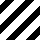
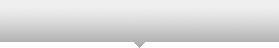
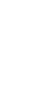
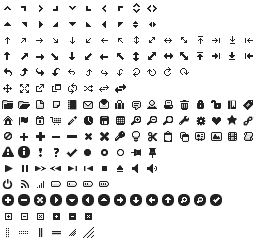
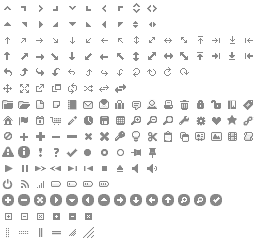
...
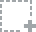
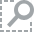
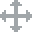
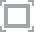
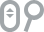

In [118]:
M = 1e5
p = 0.4
geometry_simresult = np.zeros((M,),dtype=np.int64)
for i in xrange(np.int(M)):
    c = 1
    while(nprnd.rand() > p):
        c += 1
    geometry_simresult[i] = c

x = pd.Series(geometry_simresult).value_counts().sort_index()
xi = np.array(x.index)
xv = x.values
colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="几何分布模拟频数统计与理论频数期望",
            background_fill='#59636C', y_range = [-1e4,xv.max()+1e4], **plot_config)

p1.rect(x=xi,y=xv/2,width=0.6, height=xv, color="white", alpha=0.6)
p1.line(xs,spstat.geom(p).pmf(xs)*M,\
        line_width=3,color="steelblue",legend="频数期望")
p1.legend.label_text_color = "white"

bplt.show(p1)

几何分布就是离散分布中的无记忆分布：这盘赢了实验停止，如果输了开始完全无关的比赛，仍然不会提高未来赢的预期。

下一盘你对输赢的感觉会和这盘开始之前**完全一致**。

好了，现在新的目标变成了“不赢5盘不睡觉了！”

为了迎接N盘胜利你要承受多少失败呢？一盘游戏30分钟，你知道你大概几点才能睡觉吗？！


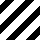
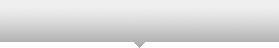
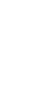
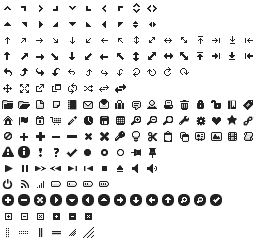
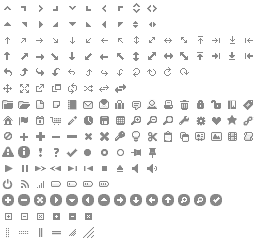
...
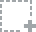
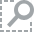
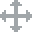
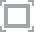
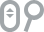

In [124]:
M = 1e5
p = 0.4
N = 5
nbinom_simresult = np.zeros((M,),dtype=np.int64)
for i in xrange(np.int(M)):
    c = 0
    win = 0
    while(win<5):
        if nprnd.rand()<p:
            win += 1
        else:
            c += 1
    nbinom_simresult[i] = c

x = pd.Series(nbinom_simresult).value_counts().sort_index()
xs = np.linspace(-1,50,256)
xi = np.array(x.index)
xv = x.values
colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="负二项分布模拟频数统计与理论频数期望",
            background_fill='#59636C', y_range = [-1e3,xv.max()+1e3], **plot_config)

p1.rect(x=xi,y=xv/2,width=0.6, height=xv, color="white", alpha=0.6)
p1.line(xs,spstat.nbinom(N,p).pmf(xs)*M,\
        line_width=3,color="steelblue",legend="频数期望")
p1.legend.label_text_color = "white"

bplt.show(p1)

###3.5 给定条件：超几何分布(Hypergeometric Distribution)

首先对条件化简：假定你的胜率变成了五五开（p = 1-p）

今天你逃课了，打了20盘LOL，在最后一盘赢到第五局才回家。

试问你前5盘赢了多少局？显然这是一个概率分布，取值从0到4都可能。

再化简一下，已知第五盘赢在20局，则前19盘只赢了4局。

联系之前提到的itertools一块解决这个问题，并对照超几何分布的PMF：

* A 事件总数
* N 某类事件在A中的总数
* X 在A中随机的k个事件中某类事件的数目

$P(X = i) = {N \choose i} \cdot {{A-N} \choose {k-i}} / {A \choose k}$ 


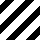
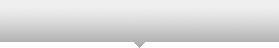
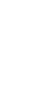
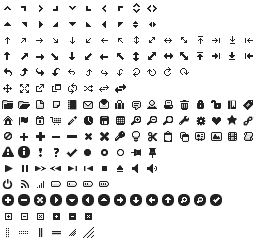
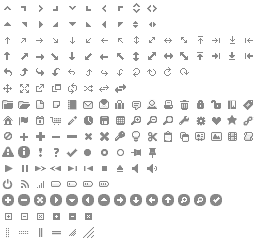
...
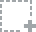
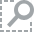
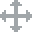
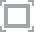
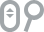

In [128]:
M = 1e5
N = 5
k = 4
A = 19
xs = np.linspace(-1,5,91)
sample_space = list(itt.combinations(xrange(A),k))
choice_idx = nprnd.rand(M)*len(sample_space)
hypergeom_simresult = np.zeros((M,),dtype=np.int64)

for i in xrange(np.int(M)):
    hypergeom_simresult[i] = np.sum(np.array(sample_space[np.int64(choice_idx[i])])<N)


x = pd.Series(hypergeom_simresult).value_counts().sort_index()
xi = np.array(x.index)
xv = x.values
colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="超几何分布模拟频数统计与理论频数期望",
            background_fill='#59636C', y_range = [-1e4,xv.max()+1e4], **plot_config)

p1.rect(x=xi,y=xv/2,width=0.6, height=xv, color="white", alpha=0.6)
p1.line(xs,spstat.hypergeom(A,k,N).pmf(xs)*M,\
        line_width=3,color="steelblue",legend="频数期望")
p1.legend.label_text_color = "white"

bplt.show(p1)

### 3.6 实践的重要注意事项

*   为合适的问题准备合适的分布
*   前提假设条件要满足

#4. 连续分布

前面已经叙述过，连续分布最好用核密度函数（KDE，Kernel Density Function）配合合适的窗口宽度来表示概率密度函数（pdf，Probability Distribution Function）。在这一章中为了美观和有效传达分布的概念，都使用KDE来描述离散样本点所形成的概率分布。

###4.1 指数分布(Exponential Distribution)

“传说中好的灯泡能用很久，不管过去工作了多少年，人们对他未来良好工作的预期都和刚拆封的新灯泡一样。”

指数分布是最容易从$U(0,1)$得到的分布，同样他是连续分布中的无记忆分布。

$Exp(\lambda): f(x) = \lambda e^{-\lambda x}$

结合条件分布我们理解一个概念：Hazard Function

对于几何分布我们已经简单尝试一下下面等式的推导：

$P(X = 1) = P(X = 2 | X>1) = P (X = 3 | X > 2) = ... = p$

对于指数分布我们继续尝试一下类似的推导对于任何X：

$f(x)/(1-F(x)) = {e^{-\lambda x}}/{\frac{1}{\lambda}e^{-\lambda x}} = \lambda $

所谓无记忆性就是Hazard Function是常数：“下一秒发生事件的概率不受这一秒之前任何事件的影响”。

无记忆性这个很好的性质导致了指数分布与几何分布有个非常相似的地方：遮住画面的左边一部分，等比例放大一下函数，和原来的形状一样。

如果把几何分布的$X ＝ x$变成$\frac{x}{N}$，将$p$替换成$\frac{p}{N}$，他其实就变成了……指数分布


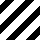
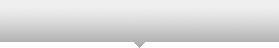
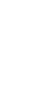
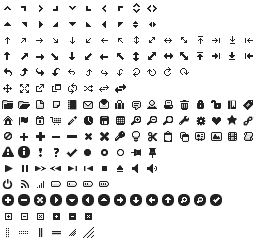
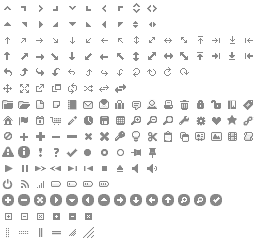
...
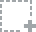
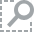
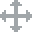
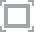
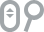

In [138]:
M = 1e5
p = nprnd.rand()*2+1
x = - np.log(nprnd.rand(M))*p # 来自均匀分布经过函数转换, lambda = 1/p
T = 10
poisson_parameter = T/p
xs = np.linspace(-0.2,3,321)
density = spstat.gaussian_kde(x)
density.covariance_factor = lambda : .01
density._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="随机模拟指数分布与真实指数分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density(xs), line_width=3, color=colors[0], legend='模拟分布')
p1.line(xs, spstat.expon(0,p).pdf(xs),line_width=3,color='black',legend='指数分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)


###3.7 停时（Stopping Time）计数问题：Poisson过程与Poisson分布

虽然是离散分布，但是放在指数分布后讲解更符合逻辑。

当你有一堆工作时长为$Exp(\lambda)$（指数分布）的灯泡，把他们排列在一起，一个坏了马上换一个新的。

提问：在某一时刻T，你用坏了几个灯泡？—— 答案是用坏的灯泡数是随机的，满足$Poisson(\lambda T)$，验证之：

我们还知道：

* 二项分布是Bernoulli序列
* Bernoulli的首达是几何分布
* 几何分布的计数步长趋近于0保持无记忆变为指数分布
* 指数分布作为首达多次累积变成Poisson分布

所以

* 二项分布令$N\rightarrow \inf,p\rightarrow 0,Np = \lambda$可以逼近Poisson分布。

因为在T走过连续时间轴时变成一个随机过程Poisson Process，也称Poisson流。对任意$t 和很小的\Delta t$就有

$P(X = PP(t+\Delta t)-PP(t) = 1 ) = \lambda \Delta t$

$P(X = PP(t+\Delta t)-PP(t) = 0 ) = 1- \lambda \Delta t$

这个二值分布是不是很像Bernoulli分布？你get了么？


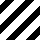
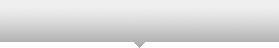
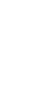
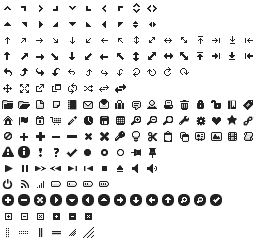
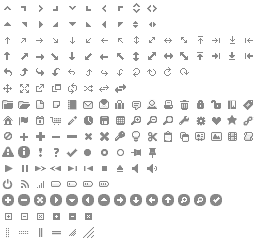
...
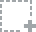
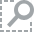
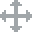
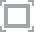
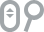

In [134]:
M = 1e5
p = nprnd.rand()*2+1

poisson_simresult = np.zeros((M,),dtype=np.int64)
T = 10
for i in xrange(np.int(M)):
    t = 0  # 计时
    c = -1 # 从－1开始计数穿过T时刻之前的事件
    while ( t < T ):
        c += 1
        t += -np.log(nprnd.rand())*p # lambda = 1/p
    poisson_simresult[i] = c

xs = np.linspace(0,20,201)
x = pd.Series(poisson_simresult).value_counts().sort_index()
xi = np.array(x.index)
xv = x.values
colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="Poisson分布模拟频数统计与理论频数期望",
            background_fill='#59636C', y_range = [-1e3,xv.max()+1e3], **plot_config)

p1.rect(x=xi,y=xv/2,width=0.6, height=xv, color="white", alpha=0.6)
p1.line(xs,spstat.poisson(T/p).pmf(xs)*M,\
        line_width=3,color="steelblue",legend="频数期望")
p1.legend.label_text_color = "white"

bplt.show(p1)

### 4.2 计时问题：Gamma分布（或称Erlang分布）

新问题：给定参数为$\lambda$的Poisson流$Poisson(\lambda)$，不再关心T时刻有多少个事件发生，而关心第N个事件发生的时间（有完没完）

$Gamma(k, loc=0, \theta=\lambda , scale=p=1/\lambda): f(x) = \frac{1}{\Gamma(k)p^k} x^{k-1}e^{-\frac{x}{p}}$


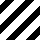
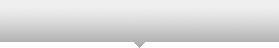
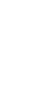
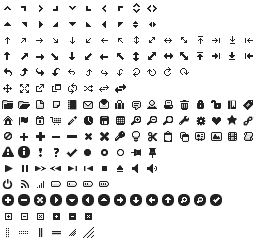
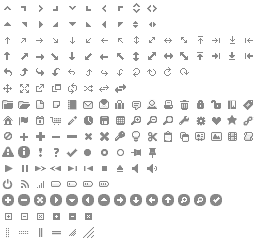
...
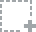
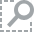
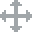
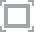
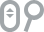

In [141]:
M = 1e5
p = nprnd.rand()*2+1 # lambda = 1/p
gamma_simresult = np.zeros((M,),dtype=np.float64)
C = nprnd.randint(3)+2


for i in xrange(np.int(M)):
    gamma_simresult[i] = np.sum(-np.log(nprnd.rand(C))*p)  # 计时

gamma_parameter = C,p
xs = np.linspace(0,30,301)
density = spstat.gaussian_kde(gamma_simresult)
density.covariance_factor = lambda : 0.02
density._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="随机模拟Gamma分布与真实Gamma分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density(xs), line_width=3, color=colors[0], legend='模拟分布')
p1.line(xs, spstat.gamma(C,loc=0.,scale=p).pdf(xs),line_width=3,color='black',legend='Gamma分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)



### 4.3 条件概率：Beta分布

新问题：给定时刻T时刚好发生了第N+1个事件，那么前N个事件中的某一个事件发生的时间点是什么？（有完没完）

给定任意时刻Poisson流事件数＝N＋1的T，前N事件发生的时间比上T的分布就是Beta分布！这个分布是与T无关永远成立的，这是一个令人惊诧的结果。

而N个$U(0,1)$的顺序统计量仍然是Beta分布！Shocked ... Again .

比较三种方式生成的分布吧：（可以自行更改k和N看看效果）

$Beta(a,b)$的PDF: 

$f(x) = \frac{\Gamma(a+b)}{\Gamma(a)\Gamma(b)} x^{a-1}(1-x)^{b-1} = \frac{1}{\mathcal{B}(a,b)}x^{a-1}(1-x)^{b-1}$


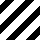
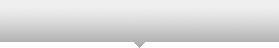
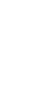
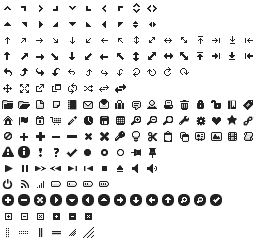
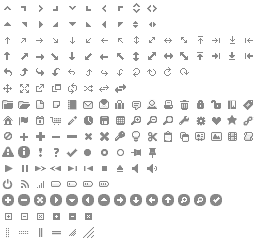
...
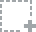
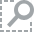
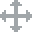
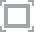
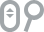

In [144]:
k = 2
N = 5
rk = N - k
p = nprnd.rand()*3+2
beta_sim1result = np.zeros((M,),dtype=np.float64)
beta_sim2result = np.zeros((M,),dtype=np.float64)


for i in xrange(np.int(M)):
    beta_sim1result[i] = np.sort(nprnd.rand(N-1))[k-1]
    firstktime = np.sum(-np.log(nprnd.rand(k)))
    lastrktime = np.sum(-np.log(nprnd.rand(N-k)))
    beta_sim2result[i] = firstktime/(firstktime+lastrktime)

xs = np.linspace(-0.1,1.1,301)
density1 = spstat.gaussian_kde(beta_sim1result)
density1.covariance_factor = lambda : 0.02
density1._compute_covariance()
density2 = spstat.gaussian_kde(beta_sim2result)
density2.covariance_factor = lambda : 0.02
density2._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="随机模拟Beta分布与真实Beta分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density1(xs), line_width=3, color=colors[0], legend='模拟分布1')
p1.line(xs, density2(xs), line_width=3, color=colors[2], legend='模拟分布2')
p1.line(xs, spstat.beta(k,rk).pdf(xs),line_width=3,color='black',legend='Beta分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

### 4.4 指数分布族的共轭分布

指数分布族：PDF或者PMF分布在参数$\theta$条件下满足

$$f_X(x|\theta) \sim \exp \left (\eta(\theta) \cdot T(x) - A(\theta) + B(x) \right )$$

$\eta(\theta)$与$T(x)$可以是向量

因为分布的积分应该等于1，所以确定等式右边的形式之后，归一化常量都会被唯一确定了。

比如正态分布

$$f(x) \sim \exp \left ( -2\cdot log(\sigma) - x^2 \frac{1}{2\sigma^2}- \frac{\mu^2}{2 \sigma^2} + x\frac{\mu}{\sigma^2} \right )$$

比如二项分布

$$P(X=k) \sim \exp \left ( -log({N \choose k})+klog(p) + (N-k)log(1-p)\right )$$

比如Gamma分布

$$f(x) \sim \exp \left ( -log(\Gamma(k))-klog(p)+(k-1)log(x)-x\frac{1}{p} \right )$$

比如Beta分布

$$f(p) \sim \exp \left ( -log(\mathcal{B}(a,b)) +(a-1)log(p)+(b-1)log(1-p)\right )$$

共轭分布是指数分布族一个非常重要的概念，能够直接指导贝叶斯推断

### 重要！！核心概念 ：贝叶斯推断，先验分布，后验分布

我们先来说人话：

今天的天气情况

$$P(天气=晴) = 0.8 , P(天气=雨) = 0.2 $$

我走在路上的情况

$$P(走路摔倒|天气=晴) = 0.1 , P(走路摔倒|天气=雨) = 0.9$$

我又额外给了你 "我今天在路上摔倒了"的信息，如何判断今天天气？

$$P(天气=雨 | 走路摔倒) = \frac{P(天气=雨, 走路摔倒)}{P(走路摔倒)} \\
=\frac{P(天气=雨, 走路摔倒)}{P(天气=雨, 走路摔倒)+P(天气=晴, 走路摔倒)} \\
= \frac{P(天气=雨)P(走路摔倒|天气=雨)}{P(天气=雨)P(走路摔倒|天气=雨)＋P(天气=晴)P(走路摔倒|天气=晴)}$$

把刚才的说法换一下

* 假设我们有预先对变量$X$的理解，也就是对其概率密度函数$P(X)$的理解
* 假设我们有基于对变量$X$如何影响变量$Y$的观测，也就是对其联合概率密度函数$P(Y|X)$的理解
* 假设我们又看到了一个对因变量$Y$的观测
* 希望在有$Y$的条件下得到关于这个样本的$P(X)$信息

这就是贝叶斯思想:

### 基于已有的经验（X的先验分布），与后来观测到的信息（被X影响的Y的信息），对X的分布进行调整，得到X的后验分布

在这一节中，如果分布的参数p能够决定变量X，而且也有参数p的先验分布，那么我们能根据X的分布来推断p的后验分布。

### 为什么说共轭分布很方便

如果一个随机变量X的分布形式是A分布，而且其参数的先验分布形式是A分布的共轭分布B分布，那么其参数的后验分布B'和B分布具有**完全一致**的形式

仔细看Beta分布和二项分布，二项分布中的p是参数，Beta分布的p则是随机变量值。

这是，一个先验分布Beta分布产生出参数后，再用参数生成对一个二项分布的观测（N次试验有k次事件）。

只不过，先验分布具有超参数2和1，后验分布的参数则是由2，1以及观测点信息共同决定的，后验分布仍然是Beta分布。在推理上是相当方便的。

这种方便的推理还有很多，因为

### 容易为指数分布族的分布找到共轭分布

比如

* Binomial的共轭：Beta
* Multinomial的共轭：Dirichlet
* Normal的共轭：Normal

现在就用代码检验一下吧！随意改变 N, k , prior_a , prior_b 看看你的结果！


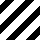
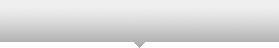
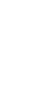
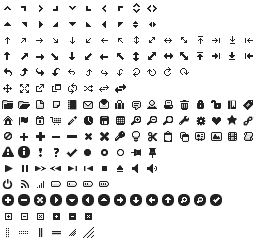
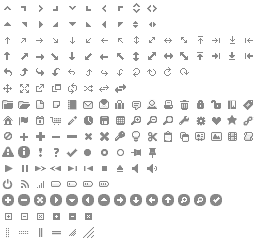
...
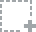
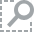
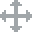
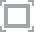
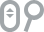

In [145]:
N = 10.
k = 3.
M = 5e5
prior_a = 2.
prior_b = 1.
post_a = prior_a + k
post_b = prior_b + N - k

#生成先验分布
ps = spstat.beta(prior_a,prior_b).rvs(np.int(M))
#生成随机二项分布
binom_simresult = spstat.binom(N,ps).rvs()
#限制二项分布的结果必须为k
restricted_binom_to_k = (binom_simresult == k)
#取出对应的p来检查分布
ps_restricted = ps[restricted_binom_to_k]

xs = np.linspace(-0.1,1.1,301)
density = spstat.gaussian_kde(ps_restricted)
density.covariance_factor = lambda : 0.02
density._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="随机模拟后验分布与真实的后验Beta分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density(xs), line_width=3, color=colors[0], legend='模拟后验分布')
p1.line(xs, spstat.beta(post_a,post_b).pdf(xs),line_width=3,color='black',legend='后验Beta分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

# 5. 回归大自然

### 5.1 正态分布

每用一次正态就要生成很多个分布然后套用中心极限定理吗？并不。
Box-Muller公式表示，2个均匀分布就能生成一对互相独立的正态分布了！

$$U \sim U(0,1), V \sim U(0,1)\\
\sqrt{-2 log(U)} sin(2\pi V) \sim \mathcal{N}(0,1), \sqrt{-2 log(U)} cos(2\pi V) \sim \mathcal{N}(0,1)$$


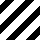
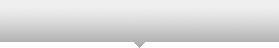
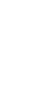
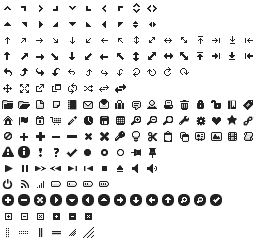
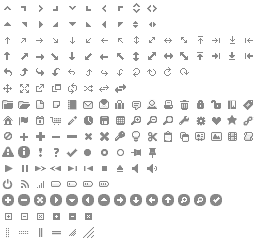
...
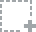
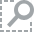
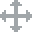
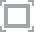
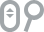

In [147]:
M = 1e5

x = np.zeros((M,),dtype=np.float64)
for i in xrange(np.int(M)/2):
    u,v = nprnd.rand(2)
    x[2*i] = np.sqrt(-2.0*np.log(u))*np.sin(2.0*np.pi*v)
    x[2*i+1] = np.sqrt(-2.0*np.log(u))*np.cos(2.0*np.pi*v)

xs = np.linspace(-5.0,5.0,3001)
density = spstat.gaussian_kde(x)
density.covariance_factor = lambda : 0.1
density._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="模拟正态分布与真实正态分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density(xs), line_width=3, color=colors[0], legend='模拟正态分布')
p1.line(xs, spstat.norm().pdf(xs),line_width=3,color='black',legend='真实正态分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

在期权定价等公式中对于标准正态分布的CDF可以用如下的函数来逼近，常见于金融工程代码。

$ \Phi(x) = 1 - \phi(x)\left(b_1t + b_2t^2 + b_3t^3 + b_4t^4 + b_5t^5\right) + \varepsilon(x), \qquad t = \frac{1}{1+b_0x}$

* b0 = 0.2316419 
* b1 = 0.319381530 
* b2 = −0.356563782
* b3 = 1.781477937
* b4 = −1.821255978
* b5 = 1.330274429

接下来的以下几个分布可以方便的从正态分布得到。

### 5.2 卡方分布

卡方分布是正态分布（随机扰动）的平方和，所以它被用来估计在假定的拟合残差的分布、方差、自由度下，残差平方和是否显著过大。

* 半整数阶的Gamma分布

PDF: $f(x) = \frac{1}{2^{\frac{k}{2}}\Gamma(\frac{k}{2})}x^{\frac{k}{2}-1}e^{-\frac{x}{2}}$

* 可以通过df个独立正态分布的平方和生成：

$\chi^2(df) \sim \Sigma_1^{df} \left( N(0,1)\right)^2$

df=2的卡方分布同分布于k＝1,scale=2的Gamma分布，也就是一个参数$\lambda$为$\frac{1}{2}$的指数分布

回忆刚才描述的Box-Muller公式，以上两点就是用2个独立均匀分布生成两个独立的正态分布的数学基础。

以下代码比较三种生成$df=4$的卡方分布：


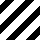
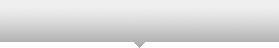
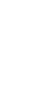
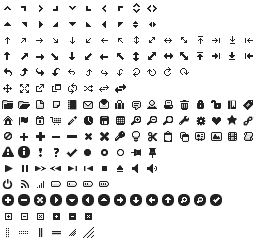
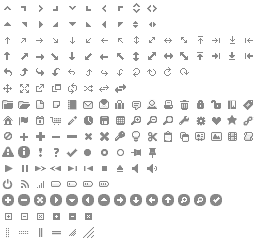
...
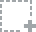
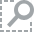
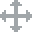
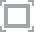
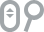

In [150]:
M = 1e5
df = 4
chisq_simresult1 = np.zeros((M,),dtype=np.float64)
chisq_simresult2 = np.zeros((M,),dtype=np.float64)
for i in xrange(np.int(M)):
    chisq_simresult1[i] = np.sum(nprnd.randn(df)**2)
    chisq_simresult2[i] = np.sum(-np.log(nprnd.rand(df/2)))*2

xs = np.linspace(0,10,301)
density1 = spstat.gaussian_kde(chisq_simresult1)
density1.covariance_factor = lambda : 0.02
density1._compute_covariance()
density2 = spstat.gaussian_kde(chisq_simresult2)
density2.covariance_factor = lambda : 0.02
density2._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="模拟卡方分布与真实卡方分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density1(xs), line_width=3, color=colors[0], legend='模拟分布1')
p1.line(xs, density2(xs), line_width=3, color=colors[2], legend='模拟分布2')
p1.line(xs, spstat.chi2(df).pdf(xs),line_width=3,color='black',legend='真实卡方分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

### 5.3 F分布

$F(m,n)$分布是两组正态分布均方之比，所以常常用来比较两组数据估计出的方差是否有显著差异（也称方差齐性）：

$F(m,n) \sim \frac{\chi^2(m)/m}{\chi^2(n)/n}$


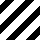
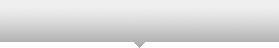
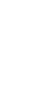
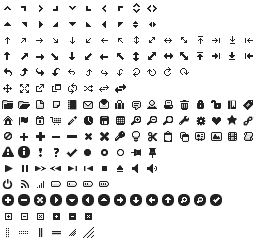
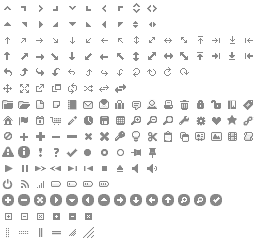
...
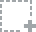
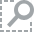
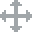
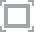
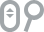

In [152]:
M = 1e5
m = 5
n = 3

f_simresult = np.zeros((M,),dtype=np.float64)
for i in xrange(np.int(M)):
    f_simresult[i] = np.mean(nprnd.randn(m)**2)/np.mean(nprnd.randn(n)**2)

xs = np.linspace(-.5,5.5,301)
density = spstat.gaussian_kde(f_simresult)
density.covariance_factor = lambda : 0.001
density._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="模拟F分布与真实F分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density(xs), line_width=3, color=colors[0], legend='模拟分布')
p1.line(xs, spstat.f(m,n).pdf(xs),line_width=3,color='black',legend='真实F分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

### 5.4 t分布

t分布是正态分布比上一个均方分布的平方根，常常用来判断在方差未知的情况下，单自由度扰动是否显著，也就是回归中“单变量的显著性”检验的指标。

$$t(df) \sim \frac{N(0,1)}{\sqrt{\chi^2(df)/df}}$$

* t分布的平方就是F(1,df)的F分布，你看出来了么？
* t的尾部比正态分布厚，但由大数定律，当$df \rightarrow \inf$时t分布会逼近标准正态分布

In [156]:
M = 1e5
df = 4

t_simresult = np.zeros((M,),dtype=np.float64)

print nprnd.randn()

for i in xrange(np.int(M)):
    t_simresult[i] = nprnd.randn()/np.sqrt(np.mean(nprnd.randn(df)**2))

xs = np.linspace(-5.0,5.0,301)
density = spstat.gaussian_kde(t_simresult)
density.covariance_factor = lambda : 0.01
density._compute_covariance()

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="模拟t分布与真实t分布",
       background_fill="#FFFFFF",**plot_config)

p1.line(xs, density(xs), line_width=3, color=colors[0], legend='模拟t分布')
p1.line(xs, spstat.t(df).pdf(xs),line_width=3,color=colors[2],legend='真实t分布')
p1.line(xs, spstat.norm().pdf(xs),line_width=3,color='black',legend='真实正态分布')
p1.set(x_range=bokeh.models.Range1d(xs.min(), xs.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

1.22545175905


# 6 统计分布的验证

我们一直在说：

### 一个满足特定分布的随机变量有什么属性和特点

我们还没说：

### 任意一组数据，如何判断它和我们已知的某种分布有多相似

今天的最后一节给出几种针对任何概率分布都适用的检验方式。

## 6.1 Kolmogorov-Smirnov检验：衡量CDF之间的距离

用累计概率密度函数衡量一组样本与一个真实分布的距离，或者两组样本之间的距离，是一种怎样的体验？

-0.0305649008477 1.84358993722
KstestResult(statistic=0.055620111760777108, pvalue=7.3402298706495128e-14)



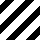
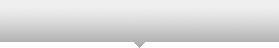
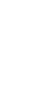
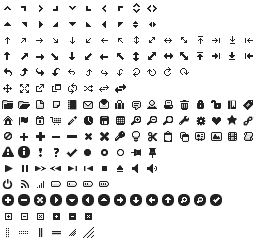
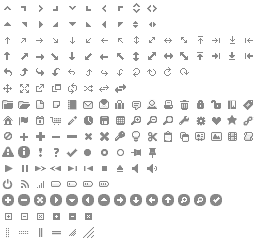
...
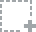
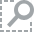
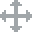
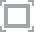
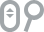

In [213]:
x = np.random.standard_t(3,5000)
x.sort()
xmean = x.mean()
xstd = x.std()*np.sqrt(5000.0/4900)
print xmean,xstd
print spstat.kstest(x,'norm')
cdf1 = np.array([spstat.norm.cdf(item) for idx,item in enumerate(x)])
cdf2 = np.array([idx/5001.0 for idx,item in enumerate(x)])
diff = np.array([spstat.norm.cdf(item)-idx/5001.0 for idx,item in enumerate(x)])
maxindex = np.argsort(np.fabs(diff))[-1]
#print maxindex
ksmarkx = [x[maxindex],x[maxindex]+1e-6]
ksmarky = [cdf1[maxindex],cdf2[maxindex]]

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=800, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="Kolmogorov-Smirnov Test",
       background_fill="#FFFFFF",**plot_config)

p1.line(x, cdf1, line_width=3, color=colors[0], legend='标准正态分布的CDF')
p1.line(x, cdf2,line_width=3,color=colors[2],legend='样本经验分布CDF')
p1.line(ksmarkx, ksmarky, line_width=3,color='black',legend='K-S最大偏差')
p1.set(x_range=bokeh.models.Range1d(-5.0, 5.0))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '随机变量取值'
p1.yaxis.axis_label = '累积概率密度函数'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

## 6.2 QQPlot：无视位置和尺度，通过分位数变量是否相近


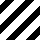
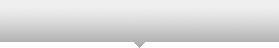
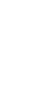
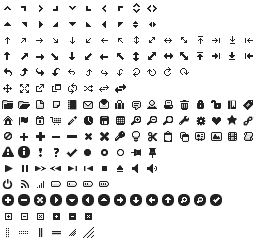
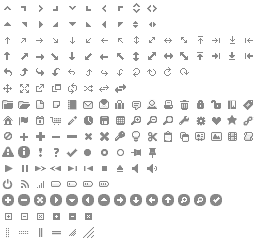
...
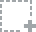
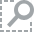
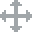
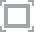
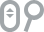

In [191]:
x1 = np.random.randn(5000)
x2 = np.random.randn(5000)*2+3
x1_percentiles = np.array([np.percentile(x1,idx) for idx in xrange(101)])
x2_percentiles = np.array([np.percentile(x2,idx) for idx in xrange(101)])

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=500, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="QQPlot: 两个正态分布",
       background_fill="#FFFFFF",**plot_config)

p1.scatter(x1_percentiles, x2_percentiles, color=colors[0], legend='QQPlot')
p1.set(x_range=bokeh.models.Range1d(x1.min(), x1.max()),y_range=bokeh.models.Range1d(x2.min(), x2.max()))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '标准正态分布'
p1.yaxis.axis_label = '非标准正态分布'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)


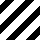
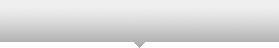
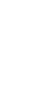
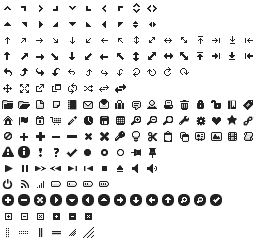
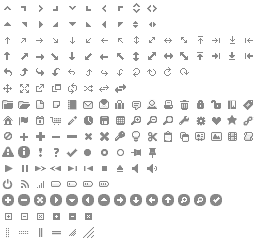
...
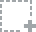
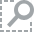
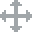
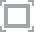
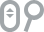

In [189]:
x1 = np.random.randn(5000)
x2 = np.random.standard_t(3,5000)
x1_percentiles = np.array([np.percentile(x1,idx/2.0) for idx in xrange(201)])
x2_percentiles = np.array([np.percentile(x2,idx/2.0) for idx in xrange(201)])

colors = bpal.brewer['RdBu'][3]
# 工具配置
TOOLS = "pan,wheel_zoom,box_zoom,box_select"
# 作图配置
plot_config = dict(plot_width=500, plot_height=500, tools=TOOLS)
bplt.output_notebook()

p1 = bplt.figure(title="QQPlot: t分布与正态分布比较",
       background_fill="#FFFFFF",**plot_config)

p1.scatter(x1_percentiles, x2_percentiles, color=colors[0], legend='QQPlot')
p1.set(x_range=bokeh.models.Range1d(x1_percentiles[1], x1_percentiles[-2]),\
       y_range=bokeh.models.Range1d(x2_percentiles[1], x2_percentiles[-2]))

p1.grid.grid_line_alpha=0.3
p1.xaxis.axis_label = '标准正态分布'
p1.yaxis.axis_label = '标准t分布，DF=3'
p1.ygrid.band_fill_color="steelblue"
p1.ygrid.band_fill_alpha = 0.1

bplt.show(p1)

## 6.3 KL散度：Kullback–Leibler Divergence

它的定义是，对于两个概率分布函数/概率密度函数P和Q

$$KLDiv(p||q) = \Sigma p(x) log \frac{p(x)}{q(x)}$$ 

也叫p相对于q的信息增益或者相对熵.

有些人，比如我，也很喜欢用这个公式的对称版本：

$$\Sigma p(x) log \frac{p(x)}{q(x)}+\Sigma q(x) log \frac{q(x)}{p(x)} = \Sigma (p(x)-q(x)) log \frac{p(x)}{q(x)}$$

因为这个对称版本是永远都是非负的。当取值为0的时候说明两个分布形式完全一致。

可以通过scipy.stats.entropy来实现：

In [167]:
arr1 = pd.Series(np.random.randint(0,5,100)).value_counts().sort_index().values
arr2 = pd.Series(np.random.randint(0,5,100)).value_counts().sort_index().values
print spstat.entropy(arr1,arr2),spstat.entropy(arr2,arr1)
print spstat.entropy(arr1,arr2)+spstat.entropy(arr2,arr1)

0.0912666926573 0.115866969769
0.207133662426
